# <u>Analysez les ventes d'une librairie avec Python</u>

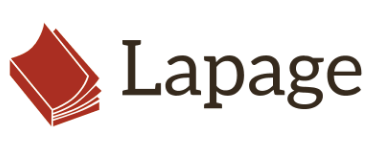

## <u> Importation des modules</u>


Commençons simplement par **l'installation des modules.**

In [1]:
import pandas as pd
from datetime import datetime as dt
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats

pd.options.display.float_format = "{:.2f}".format

In [2]:
plt.rcParams['figure.figsize'] = [14, 7]
plt.rcParams['font.size'] = 16

## <u>Création des Dataframes</u>

Pour cela rien de plus simple, j'utilise la méthode **.read_csv()** et je sauvegarde chaque Dataframe dans une variable.

In [3]:
transactions= pd.read_csv("transactions.csv",parse_dates=["date"])
products = pd.read_csv("products.csv")
customers = pd.read_csv("customers.csv")

Parfait mes **dataframes sont créés,** pour les voir il me suffit d' **"appeler" les variables auxquelles je les ai associés**.

# <u> <h1><center>PREMIERE PARTIE : NETTOYAGE </center></h1></u>

# <u>I) Nettoyage des fichiers</u>

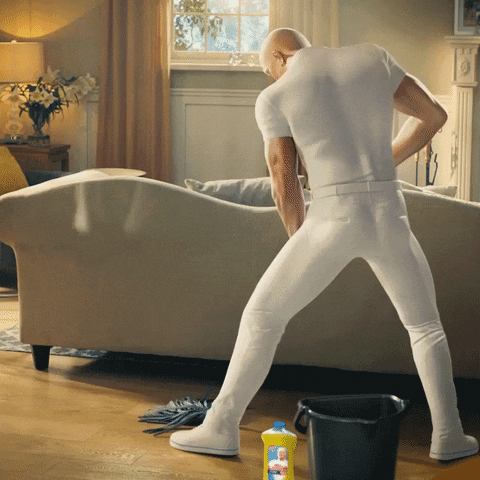

##  <u>A) Nettoyage du fichier "transactions.csv"</u>

Commençons par un **aperçu du fichier** dont il est question, avec la méthode **.head()**

In [4]:
transactions.head()

,id_prod,date,session_id,client_id
0,0_1518,2022-05-20 13:21:29.043970,s_211425,c_103
1,1_251,2022-02-02 07:55:19.149409,s_158752,c_8534
2,0_1277,2022-06-18 15:44:33.155329,s_225667,c_6714
3,2_209,2021-06-24 04:19:29.835891,s_52962,c_6941
4,0_1509,2023-01-11 08:22:08.194479,s_325227,c_4232


L'utilisation de la méthode **.shape()** nous permettra de savoir de **combien de ligne** est composé ce tableau.

In [5]:
transactions.shape

(679532, 4)

Le tableau transactions est composé de **679 532 lignes, et de 4 colonnes** ( ce qui était déjà évidement mis en valeur par la méthode **.head()**

### <u>1) Gestion des doublons du fichier "transactions.csv"</u>

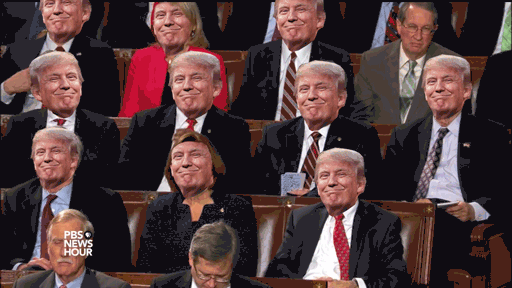

La première étape consiste à nous assurer que le fichier ne présente aucun **doublons.**<br>
Pour les déceler nous pouvons utiliser la methode **.duplicated()** que nous associerons à la méthode **.sum()**.

In [6]:
transactions.duplicated().sum()

126

Cette association de méthodes nous **renvoie le nombre 126**. Ce qui signifie que **le fichier contient 126 lignes que l'on peut considérer comme des doublons** <br>
Pour afficher les lignes utilisons la lignes de code ci-dessous

In [7]:
transactions[transactions.duplicated()]

,id_prod,date,session_id,client_id
27778,T_0,test_2021-03-01 02:30:02.237437,s_0,ct_1
52424,T_0,test_2021-03-01 02:30:02.237419,s_0,ct_0
96687,T_0,test_2021-03-01 02:30:02.237412,s_0,ct_1
130188,T_0,test_2021-03-01 02:30:02.237419,s_0,ct_0
139339,T_0,test_2021-03-01 02:30:02.237443,s_0,ct_1
...,...,...,...,...
653098,T_0,test_2021-03-01 02:30:02.237432,s_0,ct_0
657830,T_0,test_2021-03-01 02:30:02.237417,s_0,ct_0
662081,T_0,test_2021-03-01 02:30:02.237427,s_0,ct_1
671647,T_0,test_2021-03-01 02:30:02.237424,s_0,ct_1


Cette dernière renvoie toute les lignes pour lesquels, la méthode **.duplicated()** appliquée au tableau transaction renvoie la valeur **True**.

On pourrait, bien entendu **supprimer ces lignes sans aucunes autre formes de procès**, mais j'aime à croire qu'il est préférable de **prendre le temps d'analyser ces doublons afin de comprendre comment ils ont été créés.**

Sauvegardons ce résultat dans un dataframe "**transactions_doublons**" pour une **analyse détaillée**. 

In [8]:
transactions_doublons = transactions[transactions.duplicated()]

On peut très vite remarquer que, **de la première à la dernière ligne, la date semble inchangée, l'id de la session et du produit aussi**. Quant à l'id client ce dernier **semble alterner entre "ct1" et "ct2".** 
Vérifions tout ça !

Pour ce faire, je vais appliquer la méthode **.unique()** au colonnes **date, client_id, id_prod et session_id** du dataframe **transactions_doublons.**

In [9]:
transactions_doublons.client_id.unique()

array(['ct_1', 'ct_0'], dtype=object)

**L'hypothèse de départ** selon laquelle, l'id. client semble alterner entre "**ct1**" et "**ct2**" **est vérifiée.**

In [10]:
transactions_doublons.session_id.unique()

array(['s_0'], dtype=object)

Celle selon laquelle, **l'id session restait inchangé est vérifiée.**

In [11]:
transactions_doublons.id_prod.unique()

array(['T_0'], dtype=object)

Même chose pour l'**id produit qui reste égal à T_0**

In [12]:
transactions_doublons.date.unique()

array(['test_2021-03-01 02:30:02.237437',
       'test_2021-03-01 02:30:02.237419',
       'test_2021-03-01 02:30:02.237412',
       'test_2021-03-01 02:30:02.237443',
       'test_2021-03-01 02:30:02.237426',
       'test_2021-03-01 02:30:02.237436',
       'test_2021-03-01 02:30:02.237446',
       'test_2021-03-01 02:30:02.237413',
       'test_2021-03-01 02:30:02.237427',
       'test_2021-03-01 02:30:02.237445',
       'test_2021-03-01 02:30:02.237428',
       'test_2021-03-01 02:30:02.237430',
       'test_2021-03-01 02:30:02.237432',
       'test_2021-03-01 02:30:02.237438',
       'test_2021-03-01 02:30:02.237444',
       'test_2021-03-01 02:30:02.237414',
       'test_2021-03-01 02:30:02.237434',
       'test_2021-03-01 02:30:02.237415',
       'test_2021-03-01 02:30:02.237420',
       'test_2021-03-01 02:30:02.237416',
       'test_2021-03-01 02:30:02.237418',
       'test_2021-03-01 02:30:02.237447',
       'test_2021-03-01 02:30:02.237440',
       'test_2021-03-01 02:30:02.2

Concernant la date il s'agit essentiellement de la **même date et toute les valeurs présentent une mention 'test'**. On pourrait en conclure qu'il ne **s'agit que de session de test**. 
Supprimons les avec la méthode **.drop_duplicates().**

In [13]:
transactions= transactions.drop_duplicates()
transactions.duplicated().sum()

0

Ok ! les doublons ont été supprimés, esssayons de voir s'il reste des lignes associées **aux sessions de test .**

In [14]:
# affichage des données associées aux sessions de test
transactions.loc[transactions['session_id'] == 's_0']

,id_prod,date,session_id,client_id
3019,T_0,test_2021-03-01 02:30:02.237419,s_0,ct_0
5138,T_0,test_2021-03-01 02:30:02.237425,s_0,ct_0
9668,T_0,test_2021-03-01 02:30:02.237437,s_0,ct_1
10728,T_0,test_2021-03-01 02:30:02.237436,s_0,ct_0
15292,T_0,test_2021-03-01 02:30:02.237430,s_0,ct_0
...,...,...,...,...
577324,T_0,test_2021-03-01 02:30:02.237424,s_0,ct_0
593065,T_0,test_2021-03-01 02:30:02.237422,s_0,ct_1
607892,T_0,test_2021-03-01 02:30:02.237412,s_0,ct_0
626049,T_0,test_2021-03-01 02:30:02.237422,s_0,ct_0


Il en reste ! Procédons à leur suppression.

In [15]:
transactions.drop(transactions[transactions.session_id=='s_0'].index, inplace=True)

**Vérification**:

In [16]:
transactions.loc[transactions['session_id'] == 's_0']

,id_prod,date,session_id,client_id


Parfait ! Faisons la même chose pour les client **ct_0** et **ct_1.**

In [17]:
transactions.loc[transactions['client_id'] == 'ct_0']

,id_prod,date,session_id,client_id


In [18]:
transactions.loc[transactions['client_id'] == 'ct_1']

,id_prod,date,session_id,client_id


Ils ne **figurent plus dans le df** 

### <u>2) Gestion des valeurs manquantes du fichier "transactions.csv".</u>

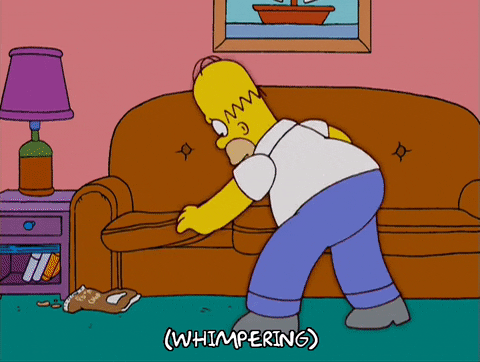

La deuxième étape consiste à **nous assurer que le fichier ne présente aucune valeurs manquantes.**
Pour les déceler nous pouvons utiliser la methode **.isnull()** que nous associerons à la méthode **.sum().**

In [19]:
transactions.isnull().sum()

id_prod       0
date          0
session_id    0
client_id     0
dtype: int64

**Parfait !** Aucune des colonnes du dataframe ne dispose de valeurs manquantes. Passons à la prochaine étape !

### <u>3) Gestion des types de données du fichier "transactions.csv".</u>

In [20]:
transactions.dtypes

id_prod       object
date          object
session_id    object
client_id     object
dtype: object

Cela aurait pu être un sans faute ! Malheureusement, la variable **date** devra être convertie en "datetime" afin que tout soit parfait.

In [21]:
transactions['date'] = pd.to_datetime(transactions['date'])

In [22]:
transactions= transactions.sort_values('date')

In [23]:
transactions

,id_prod,date,session_id,client_id
480642,0_1259,2021-03-01 00:01:07.843138,s_1,c_329
428477,0_1390,2021-03-01 00:02:26.047414,s_2,c_664
462702,0_1352,2021-03-01 00:02:38.311413,s_3,c_580
488300,0_1458,2021-03-01 00:04:54.559692,s_4,c_7912
439073,0_1358,2021-03-01 00:05:18.801198,s_5,c_2033
...,...,...,...,...
184649,1_508,2023-02-28 23:49:03.148402,s_348444,c_3573
588183,2_37,2023-02-28 23:51:29.318531,s_348445,c_50
130172,1_695,2023-02-28 23:53:18.929676,s_348446,c_488
550455,0_1547,2023-02-28 23:58:00.107815,s_348447,c_4848


In [24]:
transactions.dtypes

id_prod               object
date          datetime64[ns]
session_id            object
client_id             object
dtype: object

##  <u>B) Nettoyage du fichier "customers.csv"</u>

Commençons par un **aperçu du fichier** dont il est question, avec la méthode **.head()**

In [25]:
customers.head()

,client_id,sex,birth
0,c_4410,f,1967
1,c_7839,f,1975
2,c_1699,f,1984
3,c_5961,f,1962
4,c_5320,m,1943


L'utilisation de la méthode **.shape()** nous permettra de savoir de **combien de ligne** est composé ce tableau.

In [26]:
customers.shape

(8623, 3)

Le tableau transactions est composé de **8623 lignes, et de 4 colonnes** ( ce qui était déjà évidement mis en valeur par la méthode **.head()**)

### <u>1) Gestion des valeurs manquantes du fichier "customers.csv"

La première étape consiste à **nous assurer que le fichier ne présente aucune valeur manquante.**
Pour les déceler nous pouvons utiliser la methode **.isnull()**  que nous associerons à la méthode **.sum()**.

In [27]:
customers.isnull().sum()

client_id    0
sex          0
birth        0
dtype: int64

**Parfait !** L'association des méthodes **.isnull()** et **.sum()** nous retourne un résultat nul pour chacune des colonnes du fichier ! Autrement dit : **aucunes valeurs manquantes !**

### <u>2) Gestion des types de données du fichier "customers.csv"

Pour **s'attaquer à la gestion des types de données** nous utiliserons la méthode **.dtypes**

In [28]:
customers.dtypes

client_id    object
sex          object
birth         int64
dtype: object

On pourrait ici, tout laisser tel quel, mais de **pinaillons un peu et convertissons le type de la colonne sex d'object à category**. Utilisons la méthodes **.astype()** pour ce faire. 

In [29]:
customers["sex"] = customers["sex"].astype('category')

**Vérifions** que le changement a bien été fait.

In [30]:
customers.dtypes

client_id      object
sex          category
birth           int64
dtype: object

Parfait ! **Etape suivante !**

### <u>3) Gestion des doublons du fichier "customers.csv"

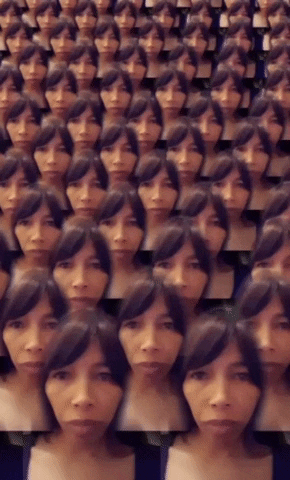

Cette étape consiste à nous assurer que **le fichier ne présente aucune doublons, aucune ligne dédoublée**. Pour les déceler nous pouvons utiliser la methode **.duplicated()** que nous associerons à la méthode **.sum()**.

In [31]:
customers.duplicated().sum()

0

**Bonne nouvelle, le dataframe ne contient pas de doublons !**

### <u>4) Suppresion des " clients-TEST " ct_0 et ct_1.

Comme on l'avait remarqué des **lignes de test étaient présentes dans le fichier "transactions.csv"** que nous avons nettoyé. Elles avaient le **même id_prod et session, et des id client qui alternaient entre ct_0 et ct_1**. Nous avons supprimer tout les doublons et il faut faire de **même avec ces deux faux clients**.
Identifions les tout d'abord grace à la méthode **.loc** .

In [32]:
ct_0 = customers.loc[customers['client_id'] == 'ct_0']
ct_1 = customers.loc[customers['client_id'] == 'ct_1']
ct_0,ct_1

(     client_id sex  birth
 2735      ct_0   f   2001,
      client_id sex  birth
 8494      ct_1   m   2001)

Il s'agit de **deux clients**, homme et femme **nés tout les deux en 2001**. Supprimons les grace à la méthode **.drop()**

In [33]:
customers.drop(customers[customers.client_id=='ct_0'].index, inplace=True)
customers.drop(customers[customers.client_id=='ct_1'].index, inplace=True)


**Vérifions** qu'il aient bien été supprimé.

In [34]:
ct_0,ct_1

(     client_id sex  birth
 2735      ct_0   f   2001,
      client_id sex  birth
 8494      ct_1   m   2001)

Parfait ! Ces deux **clients test ne sont plus présent dans le fichier "customers.csv"**. La mention **"Empty DataFrame"** nous indique que les deux tableau sont **vides.**

##  <u>C) Nettoyage du fichier "products.csv"

Commençons par un aperçu du fichier dont il est question, avec la méthode **.head()**

In [35]:
products.head()

,id_prod,price,categ
0,0_1421,19.99,0
1,0_1368,5.13,0
2,0_731,17.99,0
3,1_587,4.99,1
4,0_1507,3.99,0


L'utilisation de la méthode **.shape()** nous permettra de savoir de **combien de ligne** est composé ce tableau.

In [36]:
products.shape

(3287, 3)

Le tableau transactions est composé de **3287 lignes, et de 3 colonnes** ( ce qui était déjà évidement mis en valeur par la méthode **.head()**)

### <u>1) Gestion des valeurs manquantes

La première étape consiste à nous assurer que le fichier ne présente **aucune valeur manquante.**
Pour les déceler nous pouvons utiliser la methode **.isnull()** que nous associerons à la méthode **.sum()**.

In [37]:
products.isnull().sum()

id_prod    0
price      0
categ      0
dtype: int64

Parfait ! L'association des méthodes **.isnull()** et **.sum()** nous retourne une résultat nul pour chacune des colonnes du fichier ! Autrement dit : **aucunes valeurs manquantes** !

### <u>2) Gestion des doublons

Cette étape consiste à nous assurer que **le fichier ne présente aucune doublons**, aucune lignes dédoublée. Pour les déceler nous pouvons utiliser la methode **.duplicated()** que nous associerons à la méthode **.sum()**.

In [38]:
products.duplicated().sum()

0

Bonne nouvelle, **le dataframe ne contient pas de doublons !**

### <u>3) Gestion des types de données 

Pour s'attaquer à la **gestion des types de données nous utiliserons la méthode .dtypes**

In [39]:
products.dtypes

id_prod     object
price      float64
categ        int64
dtype: object

Aïe ! Deux sur trois ! Il va falloir changer le type de **categ**. Passons d'une type **"int64"** à un type **"category"** grace à la méthode **.astype()**.

In [40]:
products['categ'] = products['categ'].astype('category')

On verifie que le changement a bien été opéré :

In [41]:
products.dtypes

id_prod      object
price       float64
categ      category
dtype: object

**Parfait !**

### <u>4) Suppression du produit-test "T_0"

Pour rappel, des lignes de test étaient présentes dans les fichiers **"transactions.csv" et "customers.csv"** que nous avons nettoyés. Elles avaient **le même id prod et session, et des id client qui alternaient entre ct_0 et ct_1.** Nous avons supprimer tout **les doublons** et fait de même avec les **deux faux clients ( ct_0 et ct_1)**. Procédons donc à la **suppression du produit-test "T_0"** .
Identifions le tout d'abord grace à la méthode **.loc.**.

In [42]:
products.loc[products['id_prod'] == 'T_0']

,id_prod,price,categ
731,T_0,-1.00,0


On peut voir qu'en plus d'être un produit test ce dernier affiche un prix de **-1€.** Supprimons le grace à la méthode **.drop()**.

In [43]:
products.drop(products[products.id_prod=='T_0'].index, inplace=True)

Vérifions qu'il ait bien été supprimé :

In [44]:
products.loc[products['id_prod'] == 'T_0']

,id_prod,price,categ


Ok ! Il a bien été supprimé.